In [1]:
import pandas as pd
import pandas_ta as ta
import numpy as np
import vectorbt as vbt
import yfinance as yf
from datetime import datetime
import matplotlib.pyplot as plt
import pydot
import vectorbt as vbt
import ccxt


In [191]:

exchange = ccxt.binance()
symbol = 'ETH/USDT'
timeframe = '4h'


In [192]:
# get OHLCV 1h. 2 year focus on bear market begin at 2021-11-01 i want to create some stretegies to protect my wealth when bear market coming 
from_ts = exchange.parse8601('2015-11-01 00:00:00')
ohlcv_list = []
ohlcv = exchange.fetch_ohlcv(symbol, timeframe, since=from_ts, limit=1000)
ohlcv_list.append(ohlcv)
while True:
    from_ts = ohlcv[-1][0]
    new_ohlcv = exchange.fetch_ohlcv(symbol, timeframe, since=from_ts, limit=1000)
    ohlcv.extend(new_ohlcv)
    if len(new_ohlcv)!=1000:
    	break


In [193]:
ohlcv_list

[[[1502942400000, 301.13, 307.96, 298.0, 307.96, 1561.95305],
  [1502956800000, 307.95, 312.0, 307.0, 308.95, 1177.71088],
  [1502971200000, 308.95, 310.51, 303.56, 307.06, 1882.05267],
  [1502985600000, 307.74, 312.18, 298.21, 301.6, 1208.05192],
  [1503000000000, 301.6, 310.85, 299.01, 302.0, 1200.94182],
  [1503014400000, 302.0, 306.47, 295.19, 301.4, 1690.58319],
  [1503028800000, 301.4, 309.49, 298.41, 306.24, 1732.52616],
  [1503043200000, 306.24, 311.79, 303.22, 307.78, 1213.01283],
  [1503057600000, 307.78, 310.29, 296.32, 298.8, 1358.99471],
  [1503072000000, 298.8, 301.11, 287.37, 293.83, 1620.71499],
  [1503086400000, 295.46, 295.46, 283.94, 293.96, 1922.01458],
  [1503100800000, 293.31, 299.84, 292.83, 293.22, 282.19297],
  [1503115200000, 294.69, 299.9, 287.01, 290.16, 235.2921],
  [1503129600000, 290.16, 293.17, 278.0, 282.58, 1139.03045],
  [1503144000000, 281.39, 290.85, 279.56, 288.64, 288.29994],
  [1503158400000, 288.64, 295.0, 284.16, 293.31, 127.38589],
  [15031728

In [194]:
ohlcv_list = [[item[0], item[1], item[2], item[3], item[4], item[5]] for item in ohlcv_list[0]]

# create a DataFrame from the  list OHLCV from  2021-11-01 to 2023-03-16
df = pd.DataFrame(ohlcv_list, columns=['timestamp', 'open', 'high', 'low', 'close', 'volume'])



In [195]:
df

,timestamp,open,high,low,close,volume
0,1502942400000,301.13,307.96,298.00,307.96,1561.95305
1,1502956800000,307.95,312.00,307.00,308.95,1177.71088
2,1502971200000,308.95,310.51,303.56,307.06,1882.05267
3,1502985600000,307.74,312.18,298.21,301.60,1208.05192
4,1503000000000,301.60,310.85,299.01,302.00,1200.94182
...,...,...,...,...,...,...
12220,1678968000000,1660.37,1666.73,1635.96,1663.06,129192.79690
12221,1678982400000,1663.06,1691.42,1652.88,1679.64,113369.52090
12222,1678996800000,1679.64,1681.78,1652.53,1673.73,76922.01860
12223,1679011200000,1673.73,1725.00,1662.65,1708.62,166034.43070


In [196]:
# let create  strategies i will use 5 ema fast and 20 ema slow cuase i wnat to reflex about 5 trading day and 20 trading month day i know crypto 7/24 but marketmaker are work m-f and some holidy but not often
df_action=df.copy()
df_action['timestamp'] = pd.to_datetime(df['timestamp'], unit='ms')





In [197]:
df_action.reset_index(inplace=True)
df_action.set_index(df_action['timestamp'],inplace=True)
df_action


,index,timestamp,open,high,low,close,volume
timestamp,,,,,,,
2017-08-17 04:00:00,0,2017-08-17 04:00:00,301.13,307.96,298.00,307.96,1561.95305
2017-08-17 08:00:00,1,2017-08-17 08:00:00,307.95,312.00,307.00,308.95,1177.71088
2017-08-17 12:00:00,2,2017-08-17 12:00:00,308.95,310.51,303.56,307.06,1882.05267
2017-08-17 16:00:00,3,2017-08-17 16:00:00,307.74,312.18,298.21,301.60,1208.05192
2017-08-17 20:00:00,4,2017-08-17 20:00:00,301.60,310.85,299.01,302.00,1200.94182
...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,129192.79690
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,113369.52090
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,76922.01860


In [198]:
df_action.ta.macd(append=True)
df_action

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9
timestamp,,,,,,,,,,
2017-08-17 04:00:00,0,2017-08-17 04:00:00,301.13,307.96,298.00,307.96,1561.95305,NaN,NaN,NaN
2017-08-17 08:00:00,1,2017-08-17 08:00:00,307.95,312.00,307.00,308.95,1177.71088,NaN,NaN,NaN
2017-08-17 12:00:00,2,2017-08-17 12:00:00,308.95,310.51,303.56,307.06,1882.05267,NaN,NaN,NaN
2017-08-17 16:00:00,3,2017-08-17 16:00:00,307.74,312.18,298.21,301.60,1208.05192,NaN,NaN,NaN
2017-08-17 20:00:00,4,2017-08-17 20:00:00,301.60,310.85,299.01,302.00,1200.94182,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,129192.79690,26.487664,-9.729147,36.216810
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,113369.52090,26.074843,-8.113574,34.188417
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,76922.01860,24.982806,-7.364488,32.347295


In [199]:
df_action['macd_trend']= df_action.MACD_12_26_9 > df_action.MACDs_12_26_9

In [200]:
df_action.ta.rsi(append=True)

timestamp
2017-08-17 04:00:00          NaN
2017-08-17 08:00:00          NaN
2017-08-17 12:00:00          NaN
2017-08-17 16:00:00          NaN
2017-08-17 20:00:00          NaN
                         ...    
2023-03-16 12:00:00    56.716544
2023-03-16 16:00:00    59.590967
2023-03-16 20:00:00    58.109595
2023-03-17 00:00:00    63.826631
2023-03-17 04:00:00    64.854113
Name: RSI_14, Length: 12225, dtype: float64

In [201]:

df_action.loc[df_action['RSI_14']>75,'overbought']= 1
df_action.loc[df_action['RSI_14']<30,'oversold']= 1
df_action.loc[df_action['RSI_14']>50,'RSI_trend']= 1
df_action.loc[df_action['RSI_14']<50,'RSI_trend']=-1


In [202]:
df_action

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend
timestamp,,,,,,,,,,,,,,,
2017-08-17 04:00:00,0,2017-08-17 04:00:00,301.13,307.96,298.00,307.96,1561.95305,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
2017-08-17 08:00:00,1,2017-08-17 08:00:00,307.95,312.00,307.00,308.95,1177.71088,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
2017-08-17 12:00:00,2,2017-08-17 12:00:00,308.95,310.51,303.56,307.06,1882.05267,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
2017-08-17 16:00:00,3,2017-08-17 16:00:00,307.74,312.18,298.21,301.60,1208.05192,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
2017-08-17 20:00:00,4,2017-08-17 20:00:00,301.60,310.85,299.01,302.00,1200.94182,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,129192.79690,26.487664,-9.729147,36.216810,False,56.716544,NaN,NaN,1.0
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,113369.52090,26.074843,-8.113574,34.188417,False,59.590967,NaN,NaN,1.0
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,76922.01860,24.982806,-7.364488,32.347295,False,58.109595,NaN,NaN,1.0


In [203]:
df_action[df_action['macd_trend'].shift(1)!= df_action['macd_trend']]

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend
timestamp,,,,,,,,,,,,,,,
2017-08-17 04:00:00,0,2017-08-17 04:00:00,301.13,307.96,298.00,307.96,1561.95305,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
2017-08-23 00:00:00,35,2017-08-23 00:00:00,312.25,319.78,309.41,317.26,1088.33347,2.713434,0.240826,2.472607,True,55.191080,NaN,NaN,1.0
2017-08-26 00:00:00,53,2017-08-26 00:00:00,327.24,332.27,323.41,323.46,569.57801,5.218425,-0.144303,5.362728,False,53.515087,NaN,NaN,1.0
2017-08-27 16:00:00,63,2017-08-27 16:00:00,335.04,341.47,332.97,339.64,795.13177,5.146901,0.285160,4.861741,True,68.589301,NaN,NaN,1.0
2017-08-31 16:00:00,87,2017-08-31 16:00:00,384.38,387.39,383.13,384.45,878.88372,12.619776,-0.009218,12.628994,False,73.658395,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0
2023-03-08 20:00:00,12174,2023-03-08 20:00:00,1552.72,1561.29,1523.61,1532.38,128310.87040,-9.161005,-0.786086,-8.374919,False,32.613518,NaN,NaN,-1.0


In [204]:
signaled=df_action[df_action['macd_trend'].shift(1)!= df_action['macd_trend']].iloc[2:]
signaled

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend
timestamp,,,,,,,,,,,,,,,
2017-08-26 00:00:00,53,2017-08-26 00:00:00,327.24,332.27,323.41,323.46,569.57801,5.218425,-0.144303,5.362728,False,53.515087,NaN,NaN,1.0
2017-08-27 16:00:00,63,2017-08-27 16:00:00,335.04,341.47,332.97,339.64,795.13177,5.146901,0.285160,4.861741,True,68.589301,NaN,NaN,1.0
2017-08-31 16:00:00,87,2017-08-31 16:00:00,384.38,387.39,383.13,384.45,878.88372,12.619776,-0.009218,12.628994,False,73.658395,NaN,NaN,1.0
2017-09-05 16:00:00,117,2017-09-05 16:00:00,290.07,321.52,285.94,318.26,677.80125,-17.420385,0.985630,-18.406015,True,48.964468,NaN,NaN,-1.0
2017-09-08 12:00:00,134,2017-09-08 12:00:00,330.10,331.57,272.00,294.05,2343.12862,-1.422169,-0.756305,-0.665864,False,36.802842,NaN,NaN,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0
2023-03-08 20:00:00,12174,2023-03-08 20:00:00,1552.72,1561.29,1523.61,1532.38,128310.87040,-9.161005,-0.786086,-8.374919,False,32.613518,NaN,NaN,-1.0


#LET CREATE ML

In [205]:
signaled

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend
timestamp,,,,,,,,,,,,,,,
2017-08-26 00:00:00,53,2017-08-26 00:00:00,327.24,332.27,323.41,323.46,569.57801,5.218425,-0.144303,5.362728,False,53.515087,NaN,NaN,1.0
2017-08-27 16:00:00,63,2017-08-27 16:00:00,335.04,341.47,332.97,339.64,795.13177,5.146901,0.285160,4.861741,True,68.589301,NaN,NaN,1.0
2017-08-31 16:00:00,87,2017-08-31 16:00:00,384.38,387.39,383.13,384.45,878.88372,12.619776,-0.009218,12.628994,False,73.658395,NaN,NaN,1.0
2017-09-05 16:00:00,117,2017-09-05 16:00:00,290.07,321.52,285.94,318.26,677.80125,-17.420385,0.985630,-18.406015,True,48.964468,NaN,NaN,-1.0
2017-09-08 12:00:00,134,2017-09-08 12:00:00,330.10,331.57,272.00,294.05,2343.12862,-1.422169,-0.756305,-0.665864,False,36.802842,NaN,NaN,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0
2023-03-08 20:00:00,12174,2023-03-08 20:00:00,1552.72,1561.29,1523.61,1532.38,128310.87040,-9.161005,-0.786086,-8.374919,False,32.613518,NaN,NaN,-1.0


In [206]:
signaled['return']=signaled['close'].pct_change().shift(-1)
signaled

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend,return
timestamp,,,,,,,,,,,,,,,,
2017-08-26 00:00:00,53,2017-08-26 00:00:00,327.24,332.27,323.41,323.46,569.57801,5.218425,-0.144303,5.362728,False,53.515087,NaN,NaN,1.0,0.050022
2017-08-27 16:00:00,63,2017-08-27 16:00:00,335.04,341.47,332.97,339.64,795.13177,5.146901,0.285160,4.861741,True,68.589301,NaN,NaN,1.0,0.131934
2017-08-31 16:00:00,87,2017-08-31 16:00:00,384.38,387.39,383.13,384.45,878.88372,12.619776,-0.009218,12.628994,False,73.658395,NaN,NaN,1.0,-0.172168
2017-09-05 16:00:00,117,2017-09-05 16:00:00,290.07,321.52,285.94,318.26,677.80125,-17.420385,0.985630,-18.406015,True,48.964468,NaN,NaN,-1.0,-0.076070
2017-09-08 12:00:00,134,2017-09-08 12:00:00,330.10,331.57,272.00,294.05,2343.12862,-1.422169,-0.756305,-0.665864,False,36.802842,NaN,NaN,-1.0,0.026220
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0,0.001955
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0,-0.023028
2023-03-08 20:00:00,12174,2023-03-08 20:00:00,1552.72,1561.29,1523.61,1532.38,128310.87040,-9.161005,-0.786086,-8.374919,False,32.613518,NaN,NaN,-1.0,-0.054269


In [207]:
# clean data remove NaN data at last data
signaled=signaled.iloc[:-1]
signaled

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend,return
timestamp,,,,,,,,,,,,,,,,
2017-08-26 00:00:00,53,2017-08-26 00:00:00,327.24,332.27,323.41,323.46,569.57801,5.218425,-0.144303,5.362728,False,53.515087,NaN,NaN,1.0,0.050022
2017-08-27 16:00:00,63,2017-08-27 16:00:00,335.04,341.47,332.97,339.64,795.13177,5.146901,0.285160,4.861741,True,68.589301,NaN,NaN,1.0,0.131934
2017-08-31 16:00:00,87,2017-08-31 16:00:00,384.38,387.39,383.13,384.45,878.88372,12.619776,-0.009218,12.628994,False,73.658395,NaN,NaN,1.0,-0.172168
2017-09-05 16:00:00,117,2017-09-05 16:00:00,290.07,321.52,285.94,318.26,677.80125,-17.420385,0.985630,-18.406015,True,48.964468,NaN,NaN,-1.0,-0.076070
2017-09-08 12:00:00,134,2017-09-08 12:00:00,330.10,331.57,272.00,294.05,2343.12862,-1.422169,-0.756305,-0.665864,False,36.802842,NaN,NaN,-1.0,0.026220
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-02 16:00:00,12137,2023-03-02 16:00:00,1628.31,1652.48,1621.45,1648.48,78007.64970,4.138191,0.061488,4.076702,True,53.188566,NaN,NaN,1.0,-0.050374
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0,0.001955
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0,-0.023028


In [208]:
#signaled=signaled[['close','EMA_5-EMA_20','trend','return']]
signaled_filter=signaled[['close','macd_trend','overbought','oversold','RSI_trend','MACDs_12_26_9','MACD_12_26_9','RSI_14','return',]]

In [209]:
signaled_filter

,close,macd_trend,overbought,oversold,RSI_trend,MACDs_12_26_9,MACD_12_26_9,RSI_14,return
timestamp,,,,,,,,,
2017-08-26 00:00:00,323.46,False,NaN,NaN,1.0,5.362728,5.218425,53.515087,0.050022
2017-08-27 16:00:00,339.64,True,NaN,NaN,1.0,4.861741,5.146901,68.589301,0.131934
2017-08-31 16:00:00,384.45,False,NaN,NaN,1.0,12.628994,12.619776,73.658395,-0.172168
2017-09-05 16:00:00,318.26,True,NaN,NaN,-1.0,-18.406015,-17.420385,48.964468,-0.076070
2017-09-08 12:00:00,294.05,False,NaN,NaN,-1.0,-0.665864,-1.422169,36.802842,0.026220
...,...,...,...,...,...,...,...,...,...
2023-03-02 16:00:00,1648.48,True,NaN,NaN,1.0,4.076702,4.138191,53.188566,-0.050374
2023-03-03 00:00:00,1565.44,False,NaN,NaN,-1.0,2.847653,-2.231587,34.504987,0.001955
2023-03-05 08:00:00,1568.50,True,NaN,NaN,-1.0,-16.596583,-16.383615,38.888106,-0.023028


In [210]:
signaled_filter.loc[signaled_filter['return']>0,'y']=1
signaled_filter.loc[signaled_filter['return']<0,'y']=-1
signaled_filter.loc[signaled_filter['return']==0,'y']=0

/var/folders/0j/079zvm2s3dxclvzgz86_k33m0000gn/T/ipykernel_76723/4044835220.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [211]:
signaled_filter = signaled_filter.fillna(0)
signaled_filter

,close,macd_trend,overbought,oversold,RSI_trend,MACDs_12_26_9,MACD_12_26_9,RSI_14,return,y
timestamp,,,,,,,,,,
2017-08-26 00:00:00,323.46,False,0.0,0.0,1.0,5.362728,5.218425,53.515087,0.050022,1.0
2017-08-27 16:00:00,339.64,True,0.0,0.0,1.0,4.861741,5.146901,68.589301,0.131934,1.0
2017-08-31 16:00:00,384.45,False,0.0,0.0,1.0,12.628994,12.619776,73.658395,-0.172168,-1.0
2017-09-05 16:00:00,318.26,True,0.0,0.0,-1.0,-18.406015,-17.420385,48.964468,-0.076070,-1.0
2017-09-08 12:00:00,294.05,False,0.0,0.0,-1.0,-0.665864,-1.422169,36.802842,0.026220,1.0
...,...,...,...,...,...,...,...,...,...,...
2023-03-02 16:00:00,1648.48,True,0.0,0.0,1.0,4.076702,4.138191,53.188566,-0.050374,-1.0
2023-03-03 00:00:00,1565.44,False,0.0,0.0,-1.0,2.847653,-2.231587,34.504987,0.001955,1.0
2023-03-05 08:00:00,1568.50,True,0.0,0.0,-1.0,-16.596583,-16.383615,38.888106,-0.023028,-1.0


In [212]:
signaled_filter.count()

close            920
macd_trend       920
overbought       920
oversold         920
RSI_trend        920
MACDs_12_26_9    920
MACD_12_26_9     920
RSI_14           920
return           920
y                920
dtype: int64

In [213]:
#my_features = ['MACD_12_26_9','overbought','oversold','RSI_trend','EMA_7-EMA_12','Close-EMA_7' ,'z-score-MACDh','RSI_14']
X = signaled_filter.iloc[:,1:-2]
#X= signaled[my_features]
y = signaled_filter.iloc[:,-1]

In [214]:
X

,macd_trend,overbought,oversold,RSI_trend,MACDs_12_26_9,MACD_12_26_9,RSI_14
timestamp,,,,,,,
2017-08-26 00:00:00,False,0.0,0.0,1.0,5.362728,5.218425,53.515087
2017-08-27 16:00:00,True,0.0,0.0,1.0,4.861741,5.146901,68.589301
2017-08-31 16:00:00,False,0.0,0.0,1.0,12.628994,12.619776,73.658395
2017-09-05 16:00:00,True,0.0,0.0,-1.0,-18.406015,-17.420385,48.964468
2017-09-08 12:00:00,False,0.0,0.0,-1.0,-0.665864,-1.422169,36.802842
...,...,...,...,...,...,...,...
2023-03-02 16:00:00,True,0.0,0.0,1.0,4.076702,4.138191,53.188566
2023-03-03 00:00:00,False,0.0,0.0,-1.0,2.847653,-2.231587,34.504987
2023-03-05 08:00:00,True,0.0,0.0,-1.0,-16.596583,-16.383615,38.888106


In [215]:
X_train = X.iloc[:700]
y_train = y.iloc[:700]
X_test = X.iloc[700:800]
y_test = y.iloc[700:800]

In [216]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import (RandomForestRegressor, 
                              RandomForestClassifier)
from sklearn.metrics import (mean_squared_error, 
                             r2_score, 
                             mean_absolute_error,
                             mean_absolute_percentage_error, 
                             accuracy_score, 
                             precision_score, 
                             recall_score, 
                             f1_score)
from sklearn.model_selection import (GridSearchCV, 
                                     TimeSeriesSplit)

In [217]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0, shuffle=False)

In [218]:
rf =RandomForestClassifier(n_estimators=200,max_depth=3,random_state=4)
rf.fit(X_train,y_train)

RandomForestClassifier(max_depth=3, n_estimators=200, random_state=4)

In [219]:
y_pred = rf.predict(X_test)

/Users/admin/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



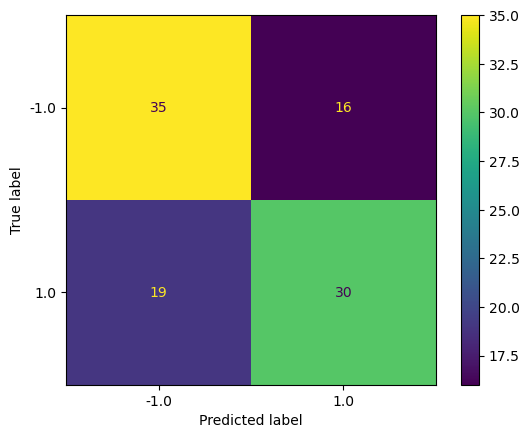

In [220]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(rf,X_test,y_test)

In [221]:
X_live = signaled_filter.iloc[100:,1:-2]

In [222]:
test_live = signaled_filter[100:].copy()
# use only last 50 data to check is ml accuracy 

test_live['signal']=rf.predict(X_live)

In [223]:
# change signal ml from -1 1. to True False cause will use to vectorbt backtest
test_live['signal']=test_live['signal'].apply(lambda x:True if x==1 else False)
test_live


,close,macd_trend,overbought,oversold,RSI_trend,MACDs_12_26_9,MACD_12_26_9,RSI_14,return,y,signal
timestamp,,,,,,,,,,,
2018-04-22 00:00:00,600.14,False,0.0,0.0,1.0,23.126038,22.931511,62.966387,0.041657,1.0,True
2018-04-22 08:00:00,625.14,True,0.0,0.0,1.0,23.071536,23.234708,69.677206,0.019548,1.0,False
2018-04-23 08:00:00,637.36,False,0.0,0.0,1.0,23.713086,23.642522,66.992778,0.049752,1.0,True
2018-04-24 00:00:00,669.07,True,0.0,0.0,1.0,23.458020,23.950860,72.530878,-0.011763,-1.0,False
2018-04-25 04:00:00,661.20,False,0.0,0.0,1.0,27.296406,25.439792,56.633962,0.028947,1.0,True
...,...,...,...,...,...,...,...,...,...,...,...
2023-03-02 16:00:00,1648.48,True,0.0,0.0,1.0,4.076702,4.138191,53.188566,-0.050374,-1.0,False
2023-03-03 00:00:00,1565.44,False,0.0,0.0,-1.0,2.847653,-2.231587,34.504987,0.001955,1.0,True
2023-03-05 08:00:00,1568.50,True,0.0,0.0,-1.0,-16.596583,-16.383615,38.888106,-0.023028,-1.0,False


In [224]:
time_predict =test_live.index[0]


In [225]:
df_predict_noml_test = df_action.loc[time_predict:, :'close']
df_predict_noml_test

,index,timestamp,open,high,low,close
timestamp,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58
...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73


In [226]:
test_live['signal']

timestamp
2018-04-22 00:00:00     True
2018-04-22 08:00:00    False
2018-04-23 08:00:00     True
2018-04-24 00:00:00    False
2018-04-25 04:00:00     True
                       ...  
2023-03-02 16:00:00    False
2023-03-03 00:00:00     True
2023-03-05 08:00:00    False
2023-03-08 20:00:00     True
2023-03-11 16:00:00    False
Name: signal, Length: 820, dtype: bool

In [227]:
df_predict_noml_test =  df_predict_noml_test.join(test_live['signal'])
df_predict_noml_test

,index,timestamp,open,high,low,close,signal
timestamp,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,True
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80,NaN
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14,False
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46,NaN
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58,NaN
...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,NaN
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,NaN
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,NaN


In [228]:
df_predict_noml_test =df_predict_noml_test.fillna(method='ffill')

In [229]:
df_predict_noml_test

,index,timestamp,open,high,low,close,signal
timestamp,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,True
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80,True
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14,False
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46,False
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58,False
...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,False
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,False
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,False


In [230]:
signal_vectorbt_ml_no_turning = df_predict_noml_test.ta.tsignals(df_predict_noml_test.signal,
                                           asbool=True,append=True)
signal_vectorbt_ml_no_turning.loc[signal_vectorbt_ml_no_turning['TS_Trades']!=0]

,TS_Trends,TS_Trades,TS_Entries,TS_Exits
timestamp,,,,
2018-04-22 08:00:00,False,-1,False,True
2018-04-23 08:00:00,True,1,True,False
2018-04-24 00:00:00,False,-1,False,True
2018-04-25 04:00:00,True,1,True,False
2018-04-27 08:00:00,False,-1,False,True
...,...,...,...,...
2023-03-02 16:00:00,False,-1,False,True
2023-03-03 00:00:00,True,1,True,False
2023-03-05 08:00:00,False,-1,False,True


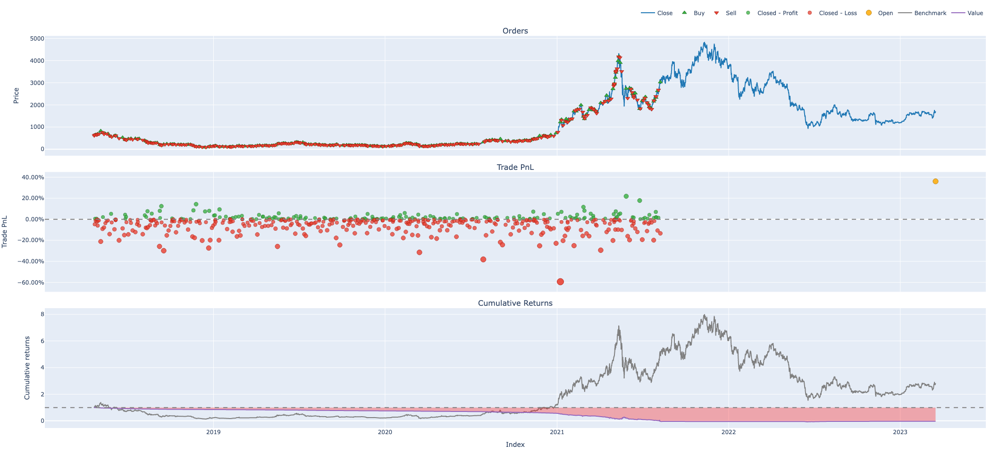

In [232]:
port_ml_filter = vbt.Portfolio.from_signals(df_predict_noml_test.open,
                                           entries=signal_vectorbt_ml_no_turning.TS_Entries,
                                           exits=signal_vectorbt_ml_no_turning.TS_Exits,
                                           freq='4H',
                                           size=0.1,
                                            direction=2,
                                            init_cash = 1000
                                           )
port_ml_filter.plot().show()

In [237]:
port_ml_filter.stats()

Start                               2018-04-22 00:00:00
End                                 2023-03-17 04:00:00
Period                               1790 days 16:00:00
Start Value                                      1000.0
End Value                                     -8.100582
Total Return [%]                            -100.810058
Benchmark Return [%]                         182.477227
Max Gross Exposure [%]                     15649.043478
Total Fees Paid                                     0.0
Max Drawdown [%]                             102.733991
Max Drawdown Duration                1790 days 04:00:00
Total Trades                                        550
Total Closed Trades                                 549
Total Open Trades                                     1
Open Trade PnL                                 4.570095
Win Rate [%]                                  30.236794
Best Trade [%]                                21.875347
Worst Trade [%]                              -59

#Grid Hyper Parameter Random Forest Classifier

In [238]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import (RandomForestRegressor, 
                              RandomForestClassifier)
from sklearn.metrics import (mean_squared_error, 
                             r2_score, 
                             mean_absolute_error,
                             mean_absolute_percentage_error, 
                             accuracy_score, 
                             precision_score, 
                             recall_score, 
                             f1_score)
from sklearn.model_selection import (GridSearchCV, 
                                     TimeSeriesSplit)

In [239]:
rf_params = {
            'n_estimators': [100,200,300],  
            'max_depth': np.arange(3,6,1),   
            'min_samples_leaf': [1,2,5,10],  
            'bootstrap': [True, False], 
            'max_features': [1, 2],
}


tscv = TimeSeriesSplit(n_splits = 5)
rf_regr = GridSearchCV(RandomForestClassifier(random_state=0), rf_params, cv=tscv, n_jobs=-1)
grid_result = rf_regr.fit(X_train, y_train)
print('Best Score: ', grid_result.best_score_)
print('Best Params: ', grid_result.best_params_)

Best Score:  0.5982758620689654
Best Params:  {'bootstrap': True, 'max_depth': 3, 'max_features': 2, 'min_samples_leaf': 2, 'n_estimators': 100}


In [240]:
clf =RandomForestClassifier(
    max_depth=grid_result.best_params_['max_depth'],
    n_estimators=grid_result.best_params_['n_estimators'],
    max_features=grid_result.best_params_['max_features'],
    min_samples_leaf=grid_result.best_params_['min_samples_leaf'],
    random_state=0)
clf.fit(X_train,y_train)

RandomForestClassifier(max_depth=3, max_features=2, min_samples_leaf=2,
                       random_state=0)

Text(0.5, 0, 'feature importance')

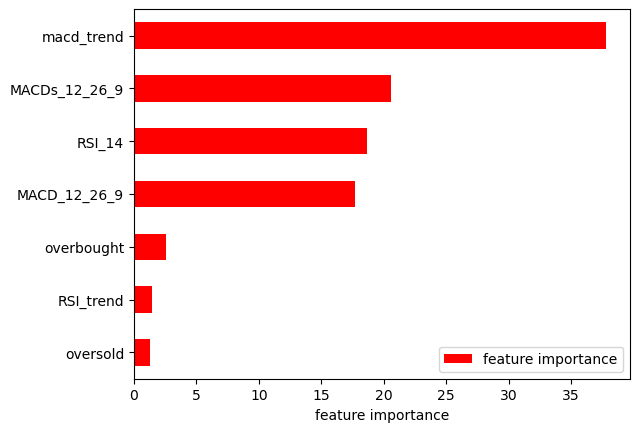

In [241]:
Importance = pd.DataFrame({'feature importance':clf.feature_importances_*100}, index=X_train.columns)
Importance.sort_values('feature importance', axis=0, ascending=True).plot(kind='barh', color='r')
plt.xlabel('feature importance')

In [242]:
y_pred = clf.predict(X_test)

In [243]:
pd.DataFrame({'actual': y_test,
              'predict': y_pred})

,actual,predict
timestamp,,
2021-11-04 08:00:00,1.0,1.0
2021-11-07 08:00:00,1.0,-1.0
2021-11-09 20:00:00,-1.0,1.0
2021-11-15 00:00:00,-1.0,-1.0
2021-11-15 20:00:00,-1.0,1.0
...,...,...
2022-05-13 04:00:00,-1.0,-1.0
2022-05-18 12:00:00,1.0,1.0
2022-05-19 16:00:00,-1.0,-1.0


/Users/admin/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.



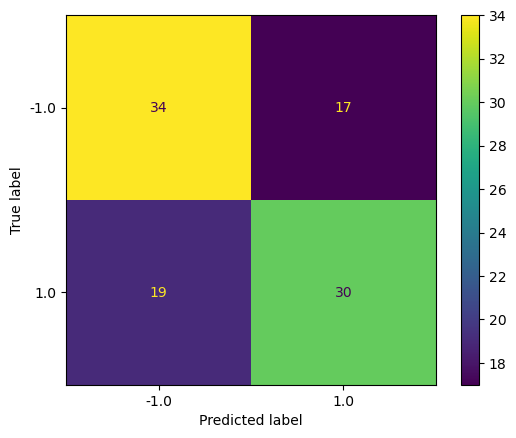

In [244]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(clf,X_test,y_test)

In [245]:
from sklearn import metrics

In [246]:
print('Accuracy:',metrics.accuracy_score(y_test,y_pred))
print('Precision:',metrics.precision_score(y_test,y_pred))
print('Recall:',metrics.recall_score(y_test,y_pred))
print('F1 Score:',metrics.f1_score(y_test,y_pred))


Accuracy: 0.64
Precision: 0.6382978723404256
Recall: 0.6122448979591837
F1 Score: 0.625


In [247]:
X_live = X.iloc[100:]
X_live

,macd_trend,overbought,oversold,RSI_trend,MACDs_12_26_9,MACD_12_26_9,RSI_14
timestamp,,,,,,,
2018-04-22 00:00:00,False,0.0,0.0,1.0,23.126038,22.931511,62.966387
2018-04-22 08:00:00,True,0.0,0.0,1.0,23.071536,23.234708,69.677206
2018-04-23 08:00:00,False,0.0,0.0,1.0,23.713086,23.642522,66.992778
2018-04-24 00:00:00,True,0.0,0.0,1.0,23.458020,23.950860,72.530878
2018-04-25 04:00:00,False,0.0,0.0,1.0,27.296406,25.439792,56.633962
...,...,...,...,...,...,...,...
2023-03-02 16:00:00,True,0.0,0.0,1.0,4.076702,4.138191,53.188566
2023-03-03 00:00:00,False,0.0,0.0,-1.0,2.847653,-2.231587,34.504987
2023-03-05 08:00:00,True,0.0,0.0,-1.0,-16.596583,-16.383615,38.888106


In [248]:
test_live = signaled[100:].copy()
test_live

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend,return
timestamp,,,,,,,,,,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,17037.36423,22.931511,-0.194527,23.126038,False,62.966387,NaN,NaN,1.0,0.041657
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14,26165.67594,23.234708,0.163172,23.071536,True,69.677206,NaN,NaN,1.0,0.019548
2018-04-23 08:00:00,1489,2018-04-23 08:00:00,641.10,642.00,630.42,637.36,15391.27247,23.642522,-0.070564,23.713086,False,66.992778,NaN,NaN,1.0,0.049752
2018-04-24 00:00:00,1493,2018-04-24 00:00:00,644.58,673.20,643.76,669.07,31087.69471,23.950860,0.492840,23.458020,True,72.530878,NaN,NaN,1.0,-0.011763
2018-04-25 04:00:00,1500,2018-04-25 04:00:00,654.00,669.00,624.00,661.20,67160.89082,25.439792,-1.856614,27.296406,False,56.633962,NaN,NaN,1.0,0.028947
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-02 16:00:00,12137,2023-03-02 16:00:00,1628.31,1652.48,1621.45,1648.48,78007.64970,4.138191,0.061488,4.076702,True,53.188566,NaN,NaN,1.0,-0.050374
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0,0.001955
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0,-0.023028


In [249]:
test_live['signal']=clf.predict(X_live)
test_live

,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend,return,signal
timestamp,,,,,,,,,,,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,17037.36423,22.931511,-0.194527,23.126038,False,62.966387,NaN,NaN,1.0,0.041657,1.0
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14,26165.67594,23.234708,0.163172,23.071536,True,69.677206,NaN,NaN,1.0,0.019548,-1.0
2018-04-23 08:00:00,1489,2018-04-23 08:00:00,641.10,642.00,630.42,637.36,15391.27247,23.642522,-0.070564,23.713086,False,66.992778,NaN,NaN,1.0,0.049752,1.0
2018-04-24 00:00:00,1493,2018-04-24 00:00:00,644.58,673.20,643.76,669.07,31087.69471,23.950860,0.492840,23.458020,True,72.530878,NaN,NaN,1.0,-0.011763,-1.0
2018-04-25 04:00:00,1500,2018-04-25 04:00:00,654.00,669.00,624.00,661.20,67160.89082,25.439792,-1.856614,27.296406,False,56.633962,NaN,NaN,1.0,0.028947,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-02 16:00:00,12137,2023-03-02 16:00:00,1628.31,1652.48,1621.45,1648.48,78007.64970,4.138191,0.061488,4.076702,True,53.188566,NaN,NaN,1.0,-0.050374,-1.0
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0,0.001955,1.0
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0,-0.023028,-1.0


In [250]:
# change signal ml from -1 1. to True False cause will use to vectorbt backtest
test_live['signal']=test_live['signal'].apply(lambda x:True if x==1 else False)
test_live


,index,timestamp,open,high,low,close,volume,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,macd_trend,RSI_14,overbought,oversold,RSI_trend,return,signal
timestamp,,,,,,,,,,,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,17037.36423,22.931511,-0.194527,23.126038,False,62.966387,NaN,NaN,1.0,0.041657,True
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14,26165.67594,23.234708,0.163172,23.071536,True,69.677206,NaN,NaN,1.0,0.019548,False
2018-04-23 08:00:00,1489,2018-04-23 08:00:00,641.10,642.00,630.42,637.36,15391.27247,23.642522,-0.070564,23.713086,False,66.992778,NaN,NaN,1.0,0.049752,True
2018-04-24 00:00:00,1493,2018-04-24 00:00:00,644.58,673.20,643.76,669.07,31087.69471,23.950860,0.492840,23.458020,True,72.530878,NaN,NaN,1.0,-0.011763,False
2018-04-25 04:00:00,1500,2018-04-25 04:00:00,654.00,669.00,624.00,661.20,67160.89082,25.439792,-1.856614,27.296406,False,56.633962,NaN,NaN,1.0,0.028947,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-02 16:00:00,12137,2023-03-02 16:00:00,1628.31,1652.48,1621.45,1648.48,78007.64970,4.138191,0.061488,4.076702,True,53.188566,NaN,NaN,1.0,-0.050374,False
2023-03-03 00:00:00,12139,2023-03-03 00:00:00,1647.86,1649.25,1544.39,1565.44,317798.34160,-2.231587,-5.079240,2.847653,False,34.504987,NaN,NaN,-1.0,0.001955,True
2023-03-05 08:00:00,12153,2023-03-05 08:00:00,1568.61,1573.07,1564.03,1568.50,32527.56420,-16.383615,0.212968,-16.596583,True,38.888106,NaN,NaN,-1.0,-0.023028,False


In [251]:
time_predict =test_live.index[0]


In [252]:
df_predict=df.copy()

In [253]:
df_predict['timestamp'] = pd.to_datetime(df['timestamp'], unit='ms')
df_predict.reset_index(inplace=True)
df_predict.set_index(df_predict['timestamp'],inplace=True)
df_predict

,index,timestamp,open,high,low,close,volume
timestamp,,,,,,,
2017-08-17 04:00:00,0,2017-08-17 04:00:00,301.13,307.96,298.00,307.96,1561.95305
2017-08-17 08:00:00,1,2017-08-17 08:00:00,307.95,312.00,307.00,308.95,1177.71088
2017-08-17 12:00:00,2,2017-08-17 12:00:00,308.95,310.51,303.56,307.06,1882.05267
2017-08-17 16:00:00,3,2017-08-17 16:00:00,307.74,312.18,298.21,301.60,1208.05192
2017-08-17 20:00:00,4,2017-08-17 20:00:00,301.60,310.85,299.01,302.00,1200.94182
...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,129192.79690
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,113369.52090
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,76922.01860


In [254]:
df_predict=df_predict.loc[time_predict:,:'close']
df_predict

,index,timestamp,open,high,low,close
timestamp,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58
...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73


In [255]:
test_live['signal']

timestamp
2018-04-22 00:00:00     True
2018-04-22 08:00:00    False
2018-04-23 08:00:00     True
2018-04-24 00:00:00    False
2018-04-25 04:00:00     True
                       ...  
2023-03-02 16:00:00    False
2023-03-03 00:00:00     True
2023-03-05 08:00:00    False
2023-03-08 20:00:00     True
2023-03-11 16:00:00    False
Name: signal, Length: 820, dtype: bool

In [256]:
df_predict

,index,timestamp,open,high,low,close
timestamp,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58
...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73


In [257]:
df_predict =  df_predict.join(test_live['signal'])
df_predict =df_predict.fillna(method='ffill')

In [258]:
df_predict

,index,timestamp,open,high,low,close,signal
timestamp,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,True
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80,True
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14,False
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46,False
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58,False
...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,False
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,False
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,False


In [259]:
df_predict[df_predict['signal']==True]

,index,timestamp,open,high,low,close,signal
timestamp,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,True
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80,True
2018-04-23 08:00:00,1489,2018-04-23 08:00:00,641.10,642.00,630.42,637.36,True
2018-04-23 12:00:00,1490,2018-04-23 12:00:00,637.45,649.11,637.03,645.23,True
2018-04-23 16:00:00,1491,2018-04-23 16:00:00,645.79,647.37,632.27,637.00,True
...,...,...,...,...,...,...,...
2023-03-10 20:00:00,12186,2023-03-10 20:00:00,1423.49,1433.45,1406.46,1426.44,True
2023-03-11 00:00:00,12187,2023-03-11 00:00:00,1426.43,1476.00,1424.57,1458.31,True
2023-03-11 04:00:00,12188,2023-03-11 04:00:00,1458.32,1466.91,1414.15,1416.65,True


In [260]:
signal_vectorbt_ml_turning = df_predict.ta.tsignals(df_predict.signal,
                                           asbool=True,append=True)

signal_vectorbt_ml_turning.loc[signal_vectorbt_ml_turning['TS_Trades']!=0]

,TS_Trends,TS_Trades,TS_Entries,TS_Exits
timestamp,,,,
2018-04-22 08:00:00,False,-1,False,True
2018-04-23 08:00:00,True,1,True,False
2018-04-24 00:00:00,False,-1,False,True
2018-04-25 04:00:00,True,1,True,False
2018-04-27 08:00:00,False,-1,False,True
...,...,...,...,...
2023-03-02 16:00:00,False,-1,False,True
2023-03-03 00:00:00,True,1,True,False
2023-03-05 08:00:00,False,-1,False,True


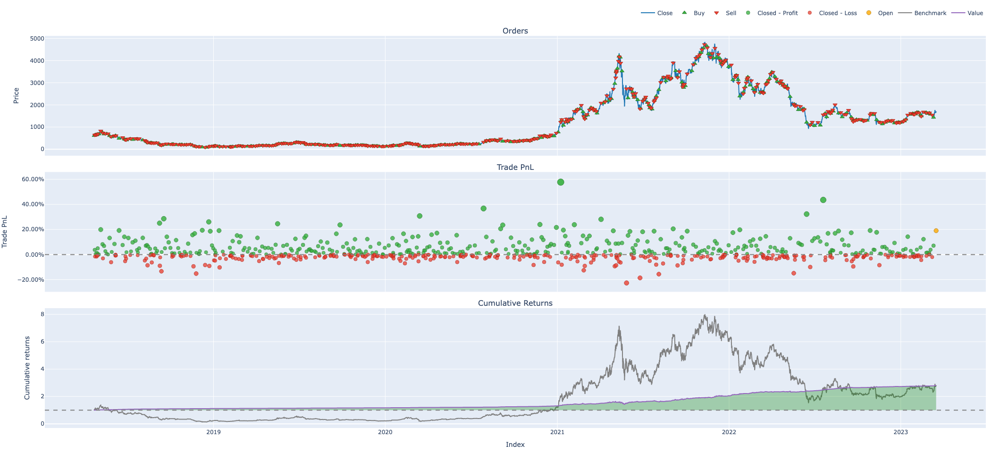

In [261]:
port_ml_turning = vbt.Portfolio.from_signals(df_predict.open,
                                            entries=signal_vectorbt_ml_turning.TS_Exits,
                                            exits=signal_vectorbt_ml_turning.TS_Entries,
                         
                        
                    
                                freq = '1h',
                                init_cash = 1000,
                                size=0.1,
                                #tp_stop=0.09,
                                fees = 0.0002,
                                direction=2,
                               slippage = 0.005,

                                          )
port_ml_turning.plot().show()

In [262]:
port_ml_turning.stats()

Start                               2018-04-22 00:00:00
End                                 2023-03-17 04:00:00
Period                                447 days 16:00:00
Start Value                                      1000.0
End Value                                   2802.131168
Total Return [%]                             180.213117
Benchmark Return [%]                         182.477227
Max Gross Exposure [%]                        27.505487
Total Fees Paid                               36.027332
Max Drawdown [%]                              13.663183
Max Drawdown Duration                  12 days 00:00:00
Total Trades                                        783
Total Closed Trades                                 782
Total Open Trades                                     1
Open Trade PnL                                27.319297
Win Rate [%]                                  51.918159
Best Trade [%]                                57.756017
Worst Trade [%]                              -22

-------
# COMPARE WITH NO ML TRADING MACD
-----

In [263]:
df_no_ml=df.copy()
df_no_ml['timestamp'] = pd.to_datetime(df_no_ml['timestamp'], unit='ms')
df_no_ml.reset_index(inplace=True)
df_no_ml.set_index(df_no_ml['timestamp'],inplace=True)
df_no_ml

,index,timestamp,open,high,low,close,volume
timestamp,,,,,,,
2017-08-17 04:00:00,0,2017-08-17 04:00:00,301.13,307.96,298.00,307.96,1561.95305
2017-08-17 08:00:00,1,2017-08-17 08:00:00,307.95,312.00,307.00,308.95,1177.71088
2017-08-17 12:00:00,2,2017-08-17 12:00:00,308.95,310.51,303.56,307.06,1882.05267
2017-08-17 16:00:00,3,2017-08-17 16:00:00,307.74,312.18,298.21,301.60,1208.05192
2017-08-17 20:00:00,4,2017-08-17 20:00:00,301.60,310.85,299.01,302.00,1200.94182
...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,129192.79690
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,113369.52090
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,76922.01860


In [264]:
df_no_ml=df_no_ml.loc[time_predict:,:'close']
df_no_ml

,index,timestamp,open,high,low,close
timestamp,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58
...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73


In [265]:
df_no_ml =  df_no_ml.join(test_live['macd_trend'])
df_no_ml =df_no_ml.fillna(method='ffill')

In [266]:
df_no_ml

,index,timestamp,open,high,low,close,macd_trend
timestamp,,,,,,,
2018-04-22 00:00:00,1481,2018-04-22 00:00:00,604.87,606.00,589.00,600.14,False
2018-04-22 04:00:00,1482,2018-04-22 04:00:00,600.22,612.49,599.00,611.80,False
2018-04-22 08:00:00,1483,2018-04-22 08:00:00,611.80,633.56,611.03,625.14,True
2018-04-22 12:00:00,1484,2018-04-22 12:00:00,625.20,641.00,614.31,634.46,True
2018-04-22 16:00:00,1485,2018-04-22 16:00:00,634.46,643.49,630.00,636.58,True
...,...,...,...,...,...,...,...
2023-03-16 12:00:00,12220,2023-03-16 12:00:00,1660.37,1666.73,1635.96,1663.06,True
2023-03-16 16:00:00,12221,2023-03-16 16:00:00,1663.06,1691.42,1652.88,1679.64,True
2023-03-16 20:00:00,12222,2023-03-16 20:00:00,1679.64,1681.78,1652.53,1673.73,True


In [267]:
signal_vectorbt_no_ml = df_no_ml.ta.tsignals(df_no_ml.macd_trend,asbool=True,append=True)


In [268]:
signal_noml_compare = signal_vectorbt_no_ml.loc[time_predict:]
signal_noml_compare

,TS_Trends,TS_Trades,TS_Entries,TS_Exits
timestamp,,,,
2018-04-22 00:00:00,False,0,False,False
2018-04-22 04:00:00,False,0,False,False
2018-04-22 08:00:00,True,1,True,False
2018-04-22 12:00:00,True,0,False,False
2018-04-22 16:00:00,True,0,False,False
...,...,...,...,...
2023-03-16 12:00:00,True,0,False,False
2023-03-16 16:00:00,True,0,False,False
2023-03-16 20:00:00,True,0,False,False


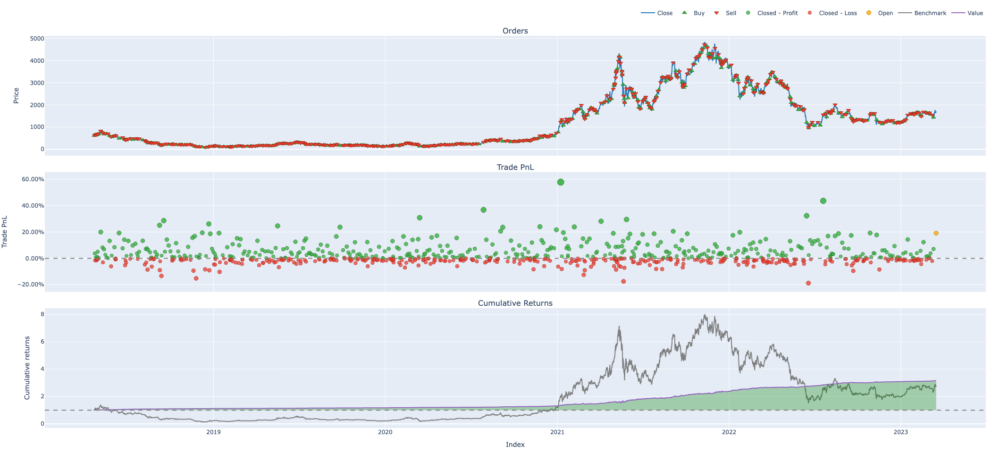

In [269]:
port_no_ml = vbt.Portfolio.from_signals(df_no_ml.open,
                                 entries = signal_noml_compare.TS_Entries,
                                 exits=signal_noml_compare.TS_Exits,
                                 freq = '1h',
                                init_cash = 1000,
                                size=0.1,
                                #tp_stop=0.09,
                                #sl_stop=0.2,
                                fees = 0.0002,
                                direction=2,
                                slippage = 0.005,
                                 )
port_no_ml.plot().show()

In [272]:
port_no_ml.stats()
# port with no ml only macd trade 

Start                               2018-04-22 00:00:00
End                                 2023-03-17 04:00:00
Period                                447 days 16:00:00
Start Value                                      1000.0
End Value                                   3159.159081
Total Return [%]                             215.915908
Benchmark Return [%]                         182.477227
Max Gross Exposure [%]                        27.319129
Total Fees Paid                               39.904049
Max Drawdown [%]                               6.122338
Max Drawdown Duration                  12 days 00:00:00
Total Trades                                        819
Total Closed Trades                                 818
Total Open Trades                                     1
Open Trade PnL                                27.319297
Win Rate [%]                                  52.322738
Best Trade [%]                                57.756017
Worst Trade [%]                              -18

In [273]:
port_ml_turning.stats()

# port with ml 

Start                               2018-04-22 00:00:00
End                                 2023-03-17 04:00:00
Period                                447 days 16:00:00
Start Value                                      1000.0
End Value                                   2802.131168
Total Return [%]                             180.213117
Benchmark Return [%]                         182.477227
Max Gross Exposure [%]                        27.505487
Total Fees Paid                               36.027332
Max Drawdown [%]                              13.663183
Max Drawdown Duration                  12 days 00:00:00
Total Trades                                        783
Total Closed Trades                                 782
Total Open Trades                                     1
Open Trade PnL                                27.319297
Win Rate [%]                                  51.918159
Best Trade [%]                                57.756017
Worst Trade [%]                              -22

# focus on trading every market anamoly like bear market eth  in 2018-2019 and bull market 2020-2021 then facing bear market 2022